In [1]:
import matplotlib
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt
import requests
from io import BytesIO

matplotlib.rcParams['font.size'] = 18
%matplotlib inline
%config InlineBackend.figure_format='retina'

### 1. Загрузка и отображение изображения:
* Выберите цветное изображение по вашему выбору (например, природа, архитектура, портрет).
* С помощью библиотек OpenCV или PIL загрузите изображение в программу.
* Отобразите исходное изображение

Загрузим изображение арт объекта из интернета через библиотеку requests и считаем через opencv, визуализируем полученное изображение и посмотрим на разрешение

image size: (667, 1000, 3)


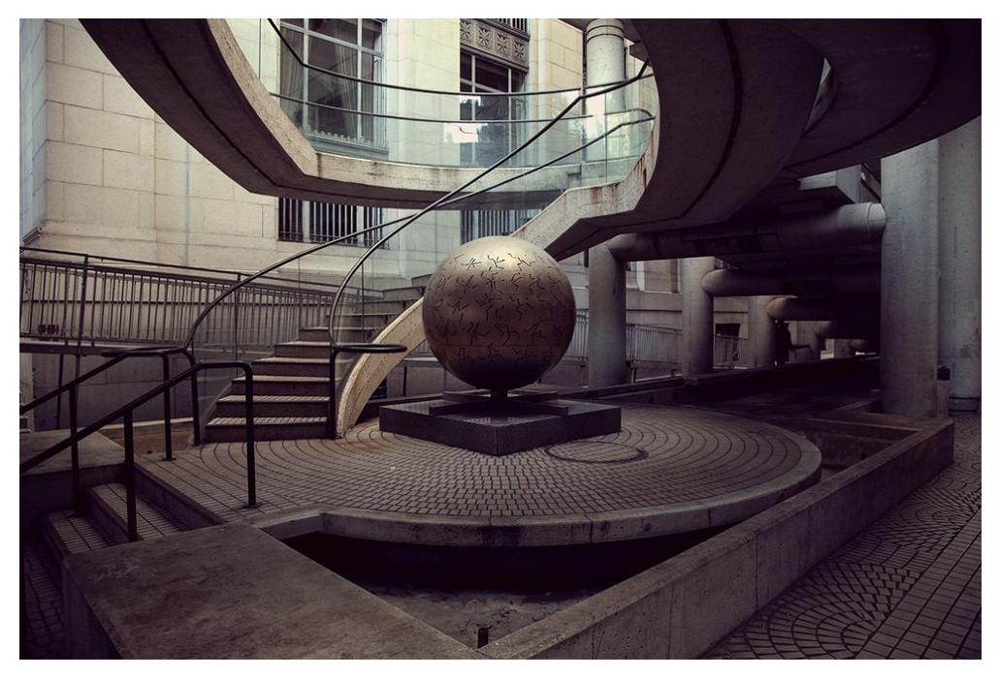

In [2]:
response = requests.get("https://photos.lensculture.com/large/fc705ed7-86c1-49db-9e27-6b0cfbdcf124.jpg")
blob = np.asarray(bytearray(BytesIO(response.content).read()), dtype=np.uint8)
img = cv.imdecode(blob, cv.IMREAD_COLOR)
plt.axis('off')
plt.imshow(img[..., ::-1])
print(f"image size: {img.shape}")

### 2. Преобразование цветовых пространств:
* Преобразуйте изображение из RGB в Grayscale и HSV.
* Отобразите каждое из полученных изображений.
* Постройте гистограммы яркости для исходного и серого изображений.

In [58]:
def plot_batch(imgs, labels=None, title="", grayscale=False, figsize=(10, 5)):
    """
    Функция для визуализации батча изображений

    Args:
        imgs (list(np.array)): list of images
        title (str, optional): 
    """
    rows = int(len(imgs) ** 0.5)
    cols = round(len(imgs) / rows)
    fig = plt.figure(figsize=figsize)
    idx = 0
    for i in range(rows):
        for j in range(cols):
            ax = fig.add_subplot(rows, cols, idx + 1)
            if idx < len(imgs):
                if labels is not None:
                    ax.set_title(labels[idx])
                if grayscale:
                    plt.imshow(imgs[idx], cmap='gray')
                else:
                    plt.imshow(imgs[idx])
                plt.axis('off')
            idx += 1
    plt.suptitle(title)
    plt.show

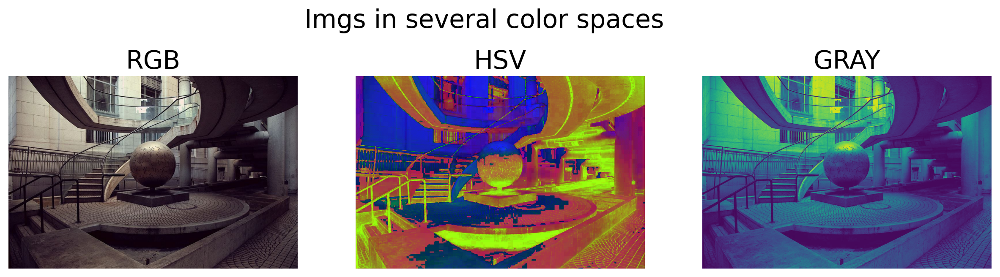

In [98]:
color_scheme_imgs = [
    cv.cvtColor(img, cv.COLOR_BGR2RGB),
    cv.cvtColor(img, cv.COLOR_BGR2HSV),
    cv.cvtColor(img, cv.COLOR_BGR2GRAY)
]
plot_batch(color_scheme_imgs, labels=["RGB", "HSV", "GRAY"], title="Imgs in several color spaces", figsize=(15, 4))

Отдельно визуализируем GrayScale цветовое пространство в 1 канальном режиме

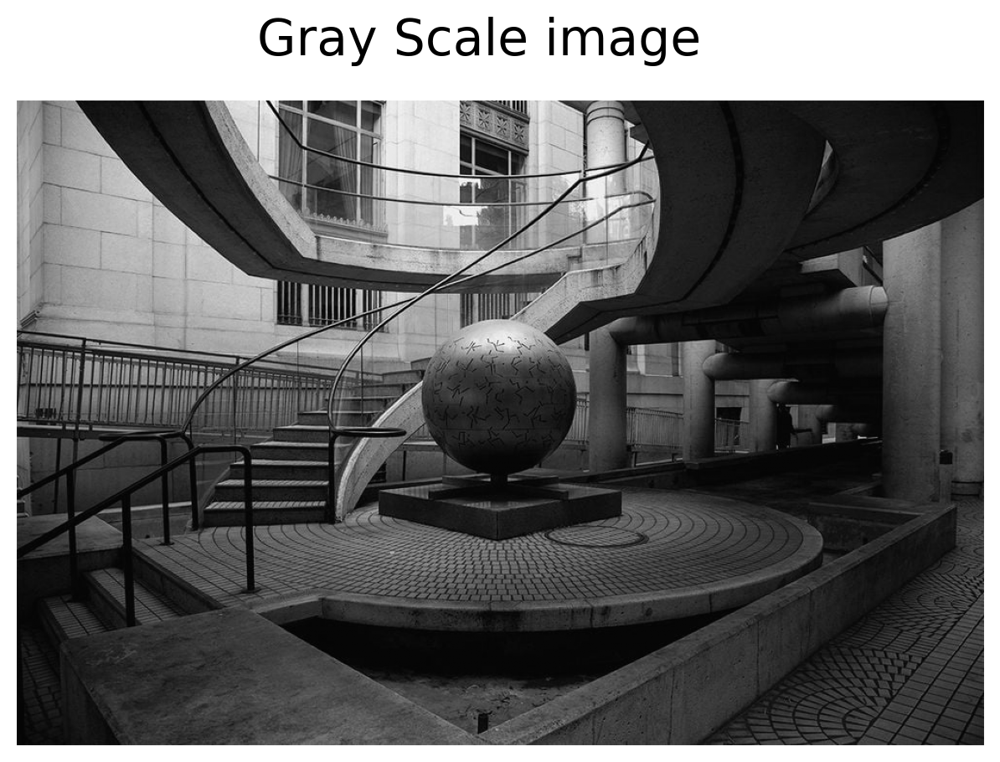

In [53]:
grayscale_img = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
plot_batch([grayscale_img], title="Gray Scale image", grayscale=True)

Теперь построим гистограммы интенсивности для RGB и GrayScale изображений

In [47]:
def plot_hist(img, title=""):
    plt.figure(figsize=(6, 3))
    hists = []
    colors = ('r', 'g', 'b')
    if img.ndim == 2:
        hists.append(cv.calcHist([img],[0], None,[256],[0,256]))
    else:
        for i in range(3):
            hists.append(cv.calcHist([img],[i], None,[256],[0,256]))
    for hist, c in zip(hists, colors):
        plt.plot(hist, color=c)
    plt.title(title)
    plt.xlim([0, 256])
    plt.show()

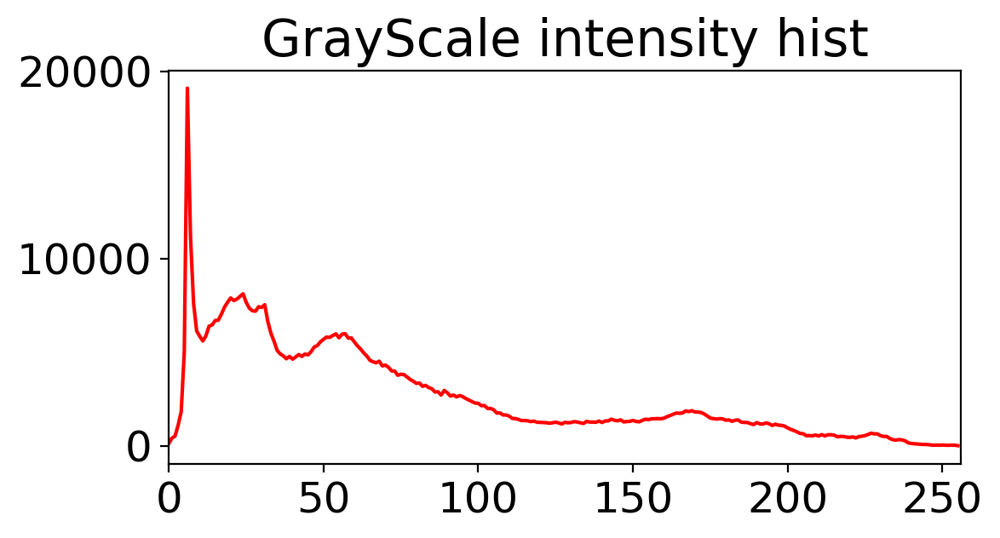

In [48]:
plot_hist(grayscale_img, "GrayScale intensity hist")

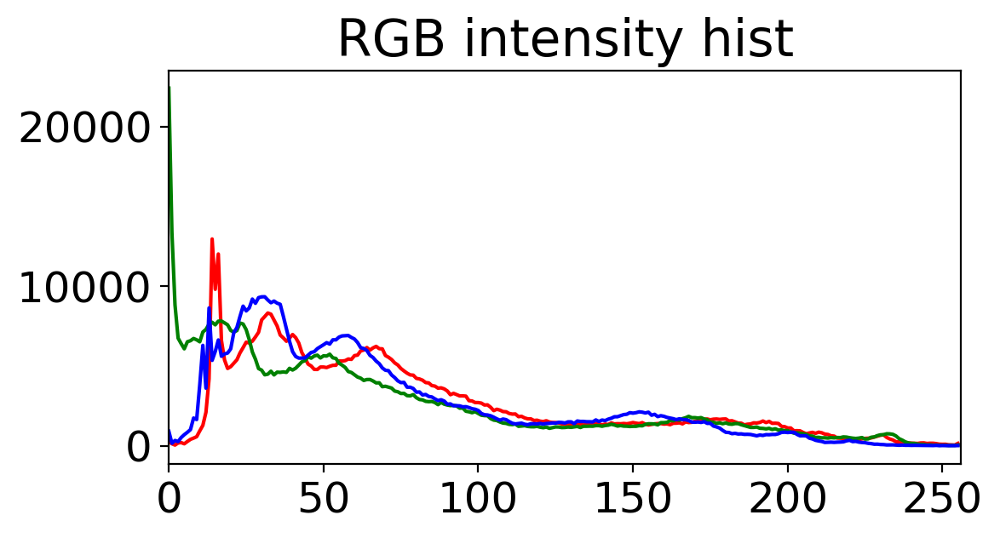

In [49]:
plot_hist(cv.cvtColor(img, cv.COLOR_BGR2RGB), title="RGB intensity hist")

### 3. Фильтрация изображений:
* Примените к серому изображению следующие фильтры:
* Гауссово сглаживание с разными значениями σ (сигма).
* Медианный фильтр с разными размерами ядра.
* Фильтр Лапласа для повышения резкости.
* Отобразите результаты фильтрации и сравните их визуально.

**Гаусов фильтр**

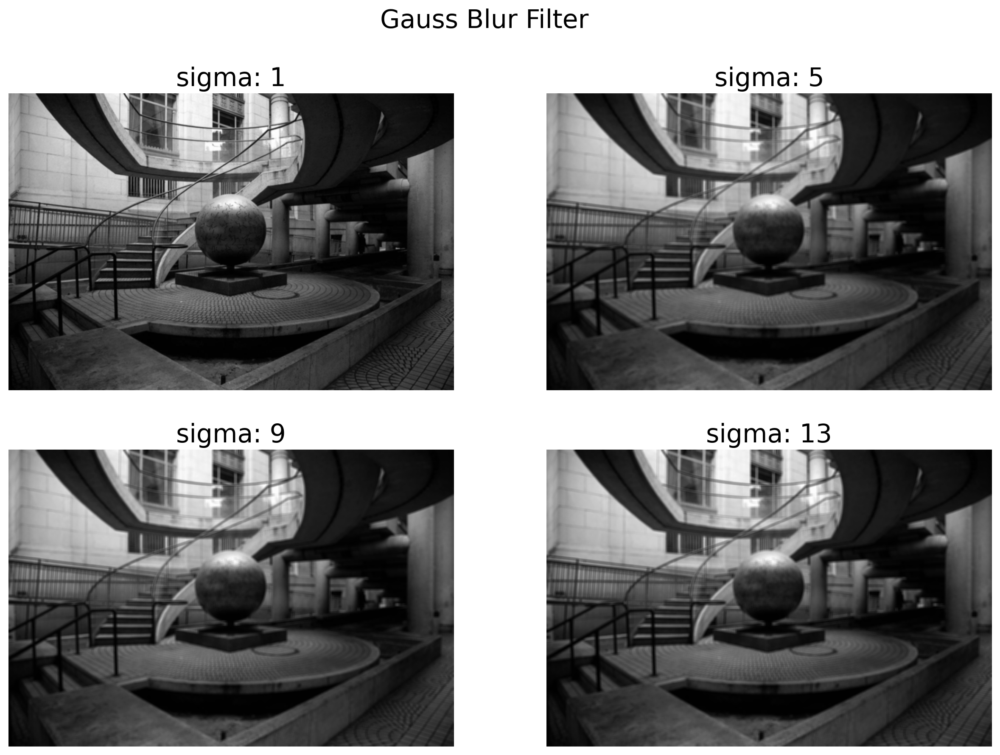

In [99]:
sigmas = range(1, 15, 4)
gauss_blur_imgs = [cv.GaussianBlur(grayscale_img, (7, 7), sigma) for sigma in sigmas]
plot_batch(gauss_blur_imgs, labels=[f"sigma: {sigma}" for sigma in sigmas], title="Gauss Blur Filter", grayscale=True, figsize=(15, 10))

Как видно по изображениям Гаусов фильтр равномерно сглаживает все изображение, сохраняя детали.

**Медианный фильтр**

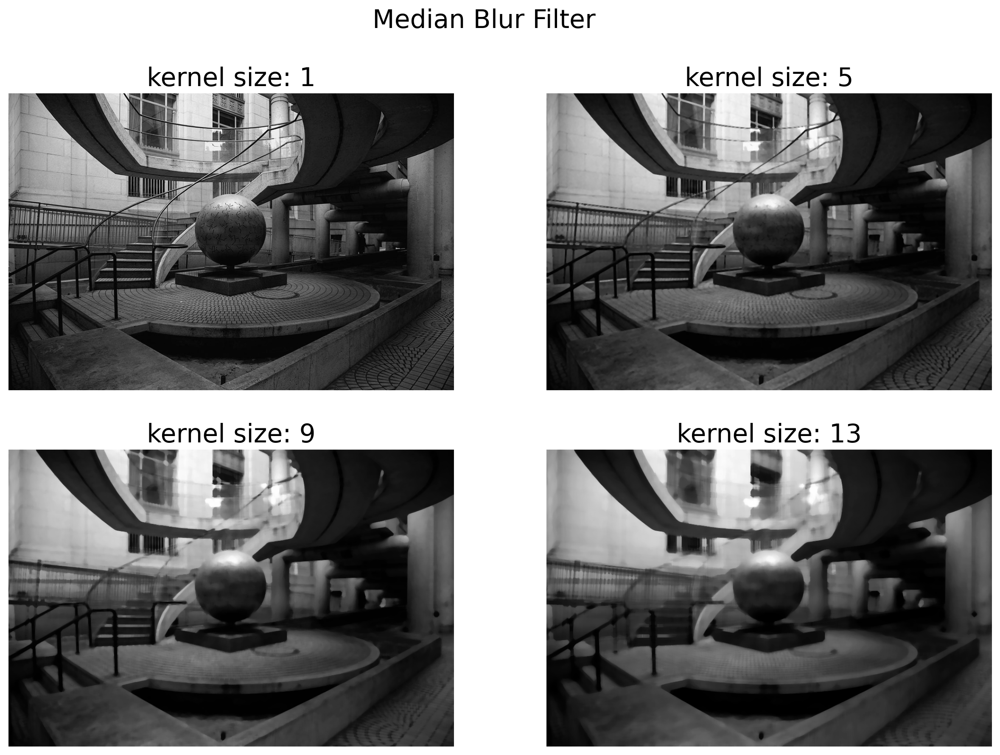

In [100]:
kernels = range(1, 21, 4)
median_blur_imgs = [cv.medianBlur(grayscale_img, kernel) for kernel in kernels]
plot_batch(median_blur_imgs, labels=[f"kernel size: {kernel}" for kernel in kernels], title="Median Blur Filter", grayscale=True, figsize=(15, 10))

Медианный фильтр в отличие от Гаусовского проводит довольно резкое сглаживание, при размере фильтра $>$ 4, тонкие текстуры уже теряют свою структуру.

**Фильтр лапласа**

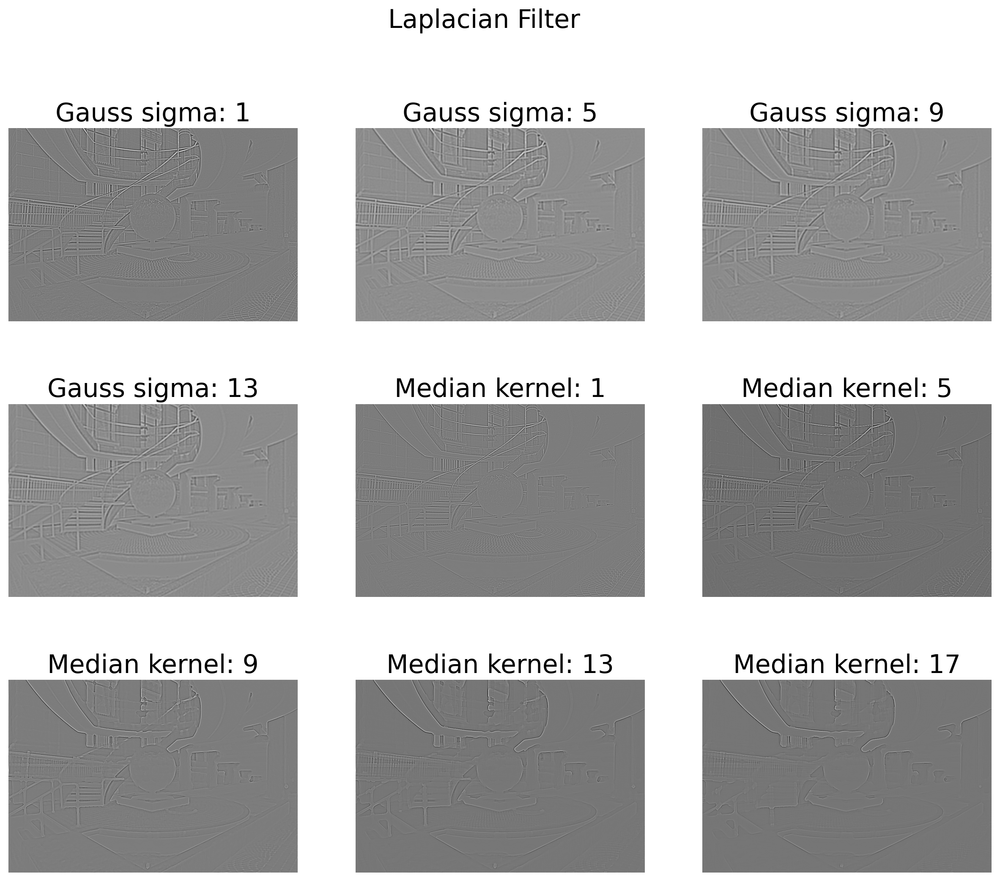

In [85]:
laplacian_filter = gauss_blur_imgs + median_blur_imgs
laplacian_filter = [cv.Laplacian(img, cv.CV_16S, ksize=5) for img in laplacian_filter]
plot_batch(laplacian_filter, labels=([f"Gauss sigma: {sigma}" for sigma in sigmas] + [f"Median kernel: {kernel}" for kernel in kernels]), title="Laplacian Filter", grayscale=True, figsize=(15, 12))

Основное применение фильтра Лапласса - выделение границ. Применение последовательного сглаживания + фильтра Лапласса дает хороший метод выделения границ. В большей степени хорошие результаты получаются при сглаживании с маленькой сигмой перед фильтром Лапласса.

Но сдесь есть опасность, что изображения не всегда в таком хорошем качестве, а к присутствию шума очень чувствителен фильтр Лапласса. 

Поэтому для выделения границ необходимо заранее озаботится сглаживающими параметрами в зависимости от предполагаемого среднего шума на изображении.

В случае шува типа соль-перец гаусов фильтр не столь эффективен, поэтому стоит использовать медианный.

### 4. Выделение краев и углов:
* Используйте оператор Собеля для определения горизонтальных и вертикальных градиентов.
* Примените алгоритм Кэнни для обнаружения краев.
* Используйте детектор углов Harris или Shi-Tomasi для выявления угловых точек.
* Наложите результаты на исходное изображение и отобразите.

**Оператор Собеля**

In [112]:
def sobel_filter(img):
    sobel_dx = cv.Sobel(img, cv.CV_16S, 1, 0, ksize=3)
    sobel_dy = cv.Sobel(img, cv.CV_16S, 0, 1, ksize=3)
    magnitude = np.sqrt(sobel_dx.astype(np.int32) ** 2 + sobel_dy.astype(np.int32)  ** 2)
    direction = np.arctan2(sobel_dy, sobel_dx)  * 180 / np.pi
    return sobel_dx, sobel_dy, magnitude, direction

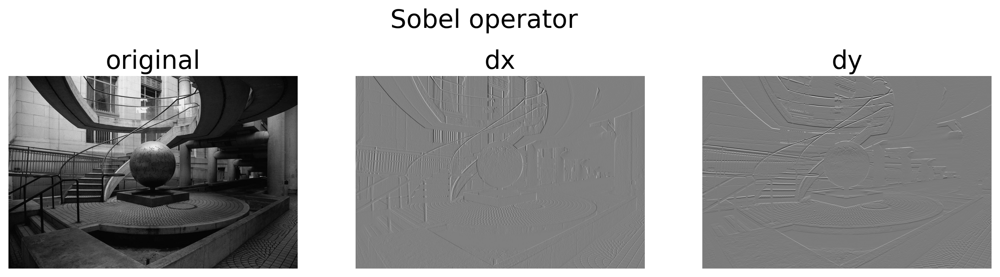

In [116]:
sobel_dx, sobel_dy, magnitude, direction = sobel_filter(grayscale_img)
plot_batch([grayscale_img, sobel_dx, sobel_dy], labels=['original', 'dx', 'dy'], title='Sobel operator', grayscale=True, figsize=(15, 4))

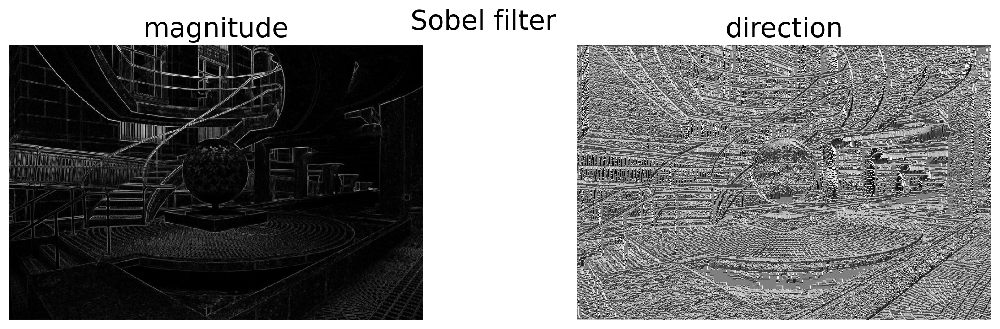

In [117]:
plot_batch([magnitude, direction], labels=['magnitude', 'direction'], title='Sobel filter', grayscale=True, figsize=(15, 4))

**Canny detector**

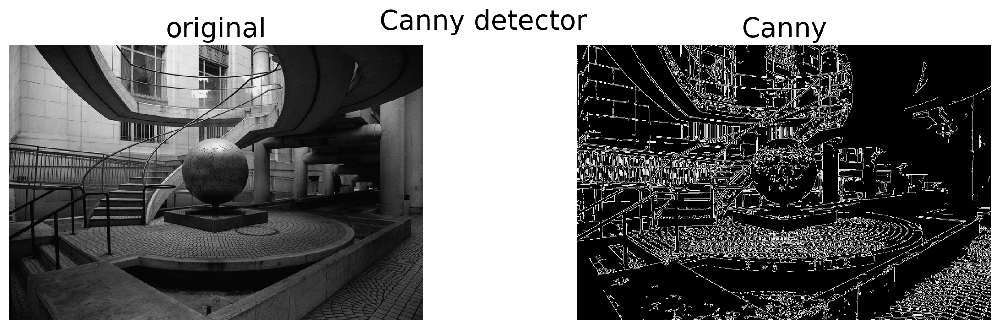

In [118]:
low_thresh = 50
high_thresh = 150
edges = cv.Canny(grayscale_img, threshold1=low_thresh, threshold2=high_thresh, apertureSize=3)
plot_batch([grayscale_img, edges], labels=['original', 'Canny',], title='Canny detector', grayscale=True, figsize=(15, 4))

**Harris detector**

In [135]:
def harris_corners(img):
    imgc = np.copy(img)
    gray = cv.cvtColor(imgc, cv.COLOR_BGR2GRAY)
    gray = np.float32(gray)
    dst = cv.cornerHarris(gray, 2, 3, 0.04)
    dst = cv.dilate(dst, None)
    imgc[dst>0.03*dst.max()] = [0, 0, 255]
    return imgc

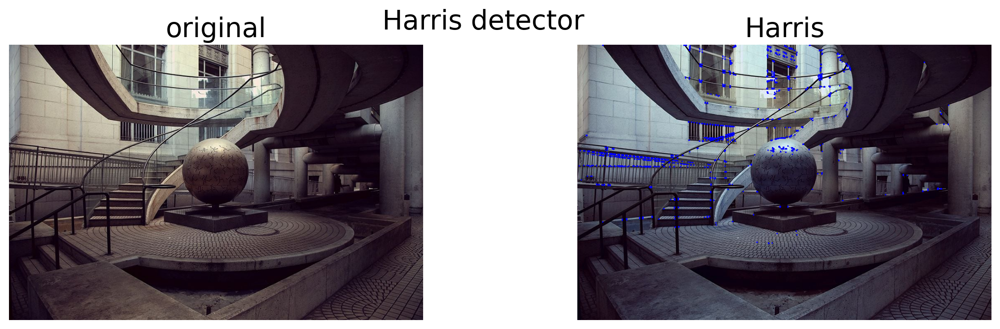

In [136]:
corners = harris_corners(img)
plot_batch([cv.cvtColor(img, cv.COLOR_BGR2RGB), corners], labels=['original', 'Harris',], title='Harris detector', grayscale=False, figsize=(15, 4))

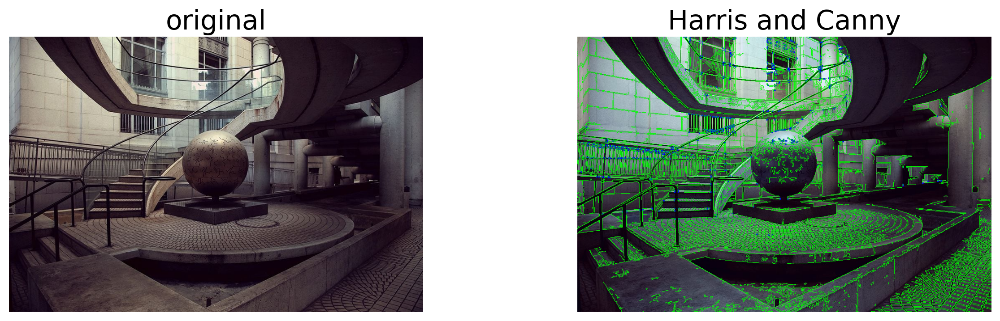

In [139]:
corners[edges != 0] = [0, 255, 0]
plot_batch([cv.cvtColor(img, cv.COLOR_BGR2RGB), corners], labels=['original', 'Harris and Canny',], title='', grayscale=False, figsize=(15, 4))

### 5. Морфологические операции:
* Бинаризуйте серое изображение с помощью пороговой сегментации.
* Примените операции эрозии и дилатации с различными структурными элементами.
* Отобразите результаты и объясните эффект каждой операции.

In [146]:
def binarize_image(gray_img, method='adaptive', block_size=11, C=1, thresh_val=127):
    if method == 'adaptive':
        bin_img = cv.adaptiveThreshold(gray_img, 255, cv.ADAPTIVE_THRESH_GAUSSIAN_C,
                                       cv.THRESH_BINARY, block_size, C)
    else:
        _, bin_img = cv.threshold(gray_img, thresh_val, 255, cv.THRESH_BINARY)
    return bin_img

def morphological_operations(bin_img, struct_elems):
    results = []
    for name, elem in struct_elems:
        eroded = cv.erode(bin_img, elem, iterations=1)
        dilated = cv.dilate(bin_img, elem, iterations=1)
        results.append((name, eroded, dilated))
    return results

In [ ]:
struct_elems = [
    ("Rect 3x3", cv.getStructuringElement(cv.MORPH_RECT, (3, 3))),
    ("Rect 7x7", cv.getStructuringElement(cv.MORPH_RECT, (7, 7))),
    ("Ellipse 5x5", cv.getStructuringElement(cv.MORPH_ELLIPSE, (5, 5))),
    ("Cross 3x3", cv.getStructuringElement(cv.MORPH_CROSS, (3, 3)))
]
bin_adaptive = binarize_image(grayscale_img, method='adaptive', block_size=15, C=5)
bin_global = binarize_image(grayscale_img, method='manual', thresh_val=100)
results_adaptive = morphological_operations(bin_adaptive, struct_elems)
results_global = morphological_operations(bin_global, struct_elems)

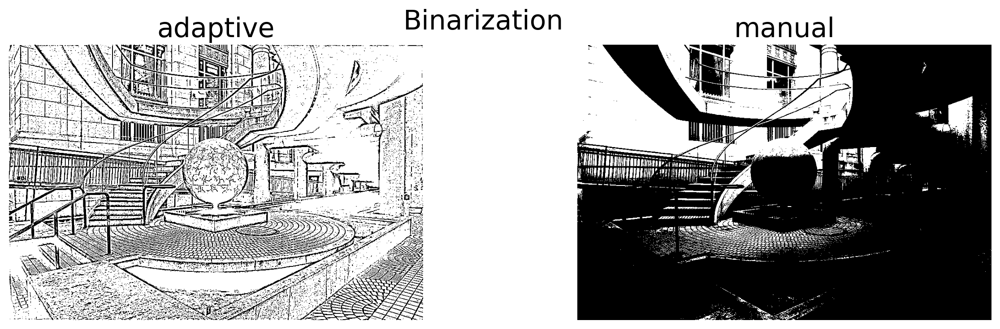

In [152]:
plot_batch([bin_adaptive, bin_global],  labels=['adaptive', 'manual'], title='Binarization', grayscale=True, figsize=(15, 4))

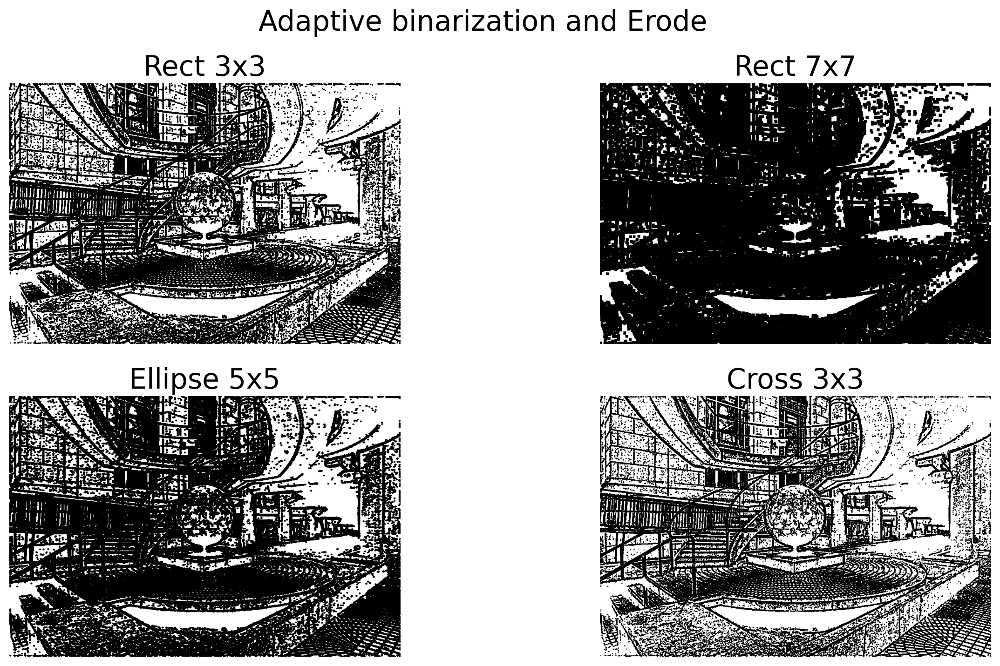

In [168]:
plot_batch([erode for _, erode, _ in results_adaptive],  labels=[name for name, _ in struct_elems], title='Adaptive binarization and Erode', grayscale=True, figsize=(15, 8))

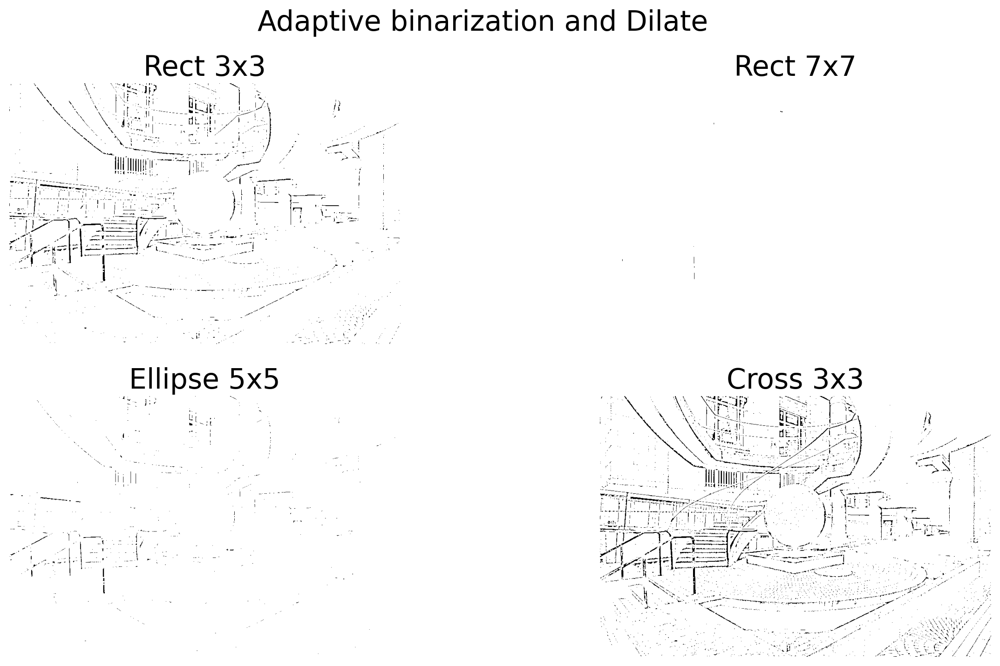

In [169]:
plot_batch([dilate for _, _, dilate in results_adaptive],  labels=[name for name, _ in struct_elems], title='Adaptive binarization and Dilate', grayscale=True, figsize=(15, 8))

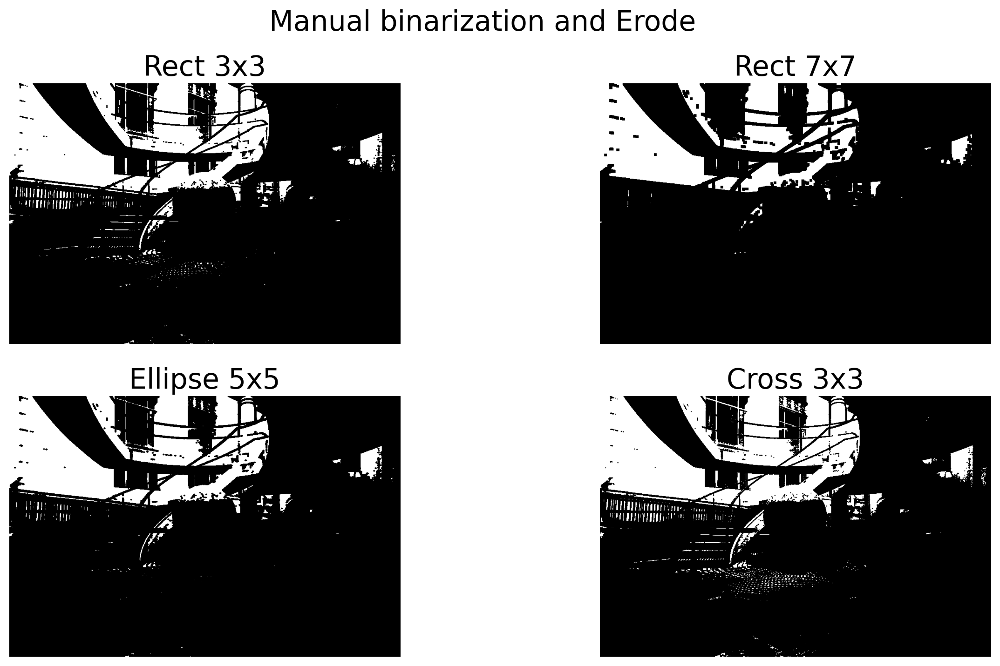

In [170]:
plot_batch([erode for _, erode, _ in results_global],  labels=[name for name, _ in struct_elems], title='Manual binarization and Erode', grayscale=True, figsize=(15, 8))

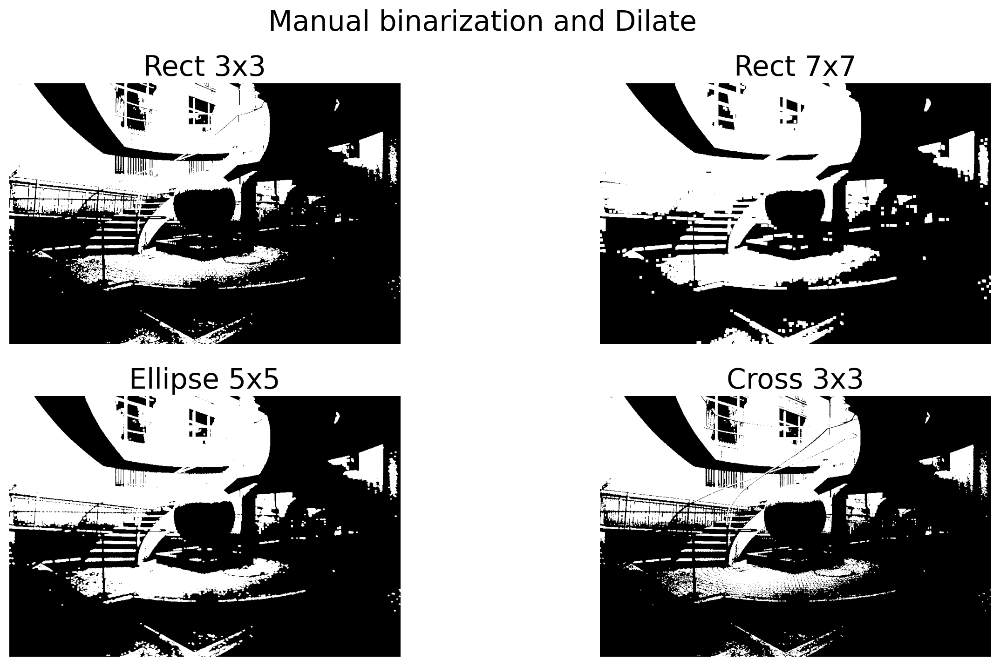

In [171]:
plot_batch([dilate for _, _, dilate in results_global],  labels=[name for name, _ in struct_elems], title='Manual binarization and Dilate', grayscale=True, figsize=(15, 8))